In [1]:
import os
import pandas as pd
import numpy as np
import pkg_resources

# Raw Data Loading

In [2]:
df = pd.read_csv('dataset.csv')

In [3]:
df.dtypes

id                    int64
sale_date            object
sale_price            int64
sale_nbr            float64
sale_warning         object
join_status          object
join_year             int64
latitude            float64
longitude           float64
area                  int64
city                 object
zoning               object
subdivision          object
present_use           int64
land_val              int64
imp_val               int64
year_built            int64
year_reno             int64
sqft_lot              int64
sqft                  int64
sqft_1                int64
sqft_fbsmt            int64
grade                 int64
fbsmt_grade           int64
condition             int64
stories             float64
beds                  int64
bath_full             int64
bath_3qtr             int64
bath_half             int64
garb_sqft             int64
gara_sqft             int64
wfnt                  int64
golf                  int64
greenbelt             int64
noise_traffic       

# Feature engineering

In [3]:
#Consider null columns
print(df.columns[df.isna().sum()>0])
drop_cols = ['id', 'join_year', 'join_status']

if 'id' in df.columns:
    df.drop(drop_cols, axis='columns',inplace=True)
df['sale_nbr'] = df['sale_nbr'].astype(int,errors='ignore')
df['sale_nbr'] = df['sale_nbr'].fillna(0) #first time sales
# Lets fill submarket with new class
df['submarket'] = df['submarket'].fillna('NEW_CLASS')
print(df.columns[df.isna().sum()>0])

Index(['sale_nbr', 'subdivision', 'submarket'], dtype='object')
Index(['subdivision'], dtype='object')


In [4]:
def extract_date_parts(df, date_column):
    df[date_column] = pd.to_datetime(df[date_column]) # ensure datetime format

    df[f'{date_column}_quarter'] = df[date_column].dt.quarter
    df[f'{date_column}_month'] = df[date_column].dt.month
    df[f'{date_column}_week'] = (df[date_column].dt.isocalendar().week).astype(int)
    df[f'{date_column}_day'] = df[date_column].dt.day
    df[f'{date_column}_day_of_week'] = (df[date_column].dt.dayofweek).astype(int)
    df[f'{date_column}_is_weekend'] = df[date_column].dt.dayofweek >= 5
#Create time features
extract_date_parts(df,'sale_date')

In [5]:
df['sale_year'] = df['sale_date'].dt.year

# EDA 

In [ ]:
df.noise_traffic.value_counts()

0    173076
1     15708
2      9730
3      1486
Name: noise_traffic, dtype: int64

In [ ]:
import plotly.io as pio
pio.renderers.default = "jupyterlab" 

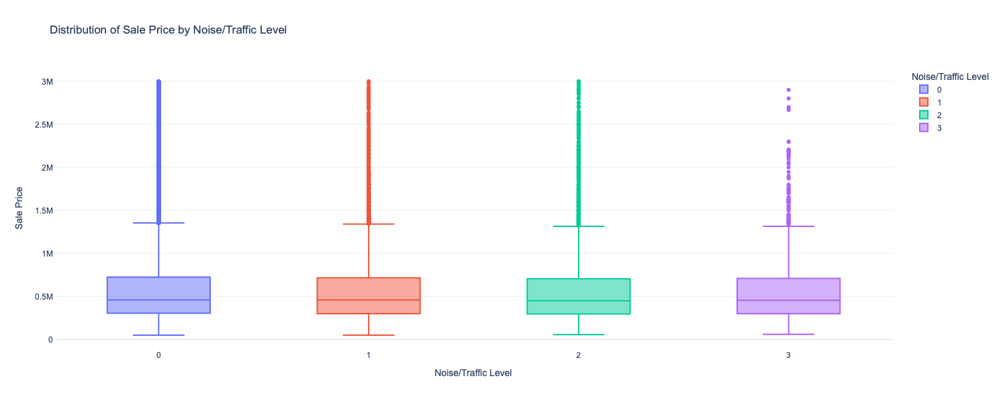

In [14]:
import plotly.express as px
import pandas as pd

df['noise_traffic'] = df['noise_traffic'].astype(str)


fig = px.box( 
    df,
    x='noise_traffic',  
    y='sale_price',     
    title='Distribution of Sale Price by Noise/Traffic Level',
    labels={
        "noise_traffic": "Noise/Traffic Level",
        "sale_price": "Sale Price"
    },
    color='noise_traffic', 
    points="outliers" 
)

fig.update_layout(
    font=dict(
        family="Arial, sans-serif",
        size=12,
    ),
    template="plotly_white",
    width=800,  
    height=600
)


fig.show()

Violin Plot for Original Sale Price:


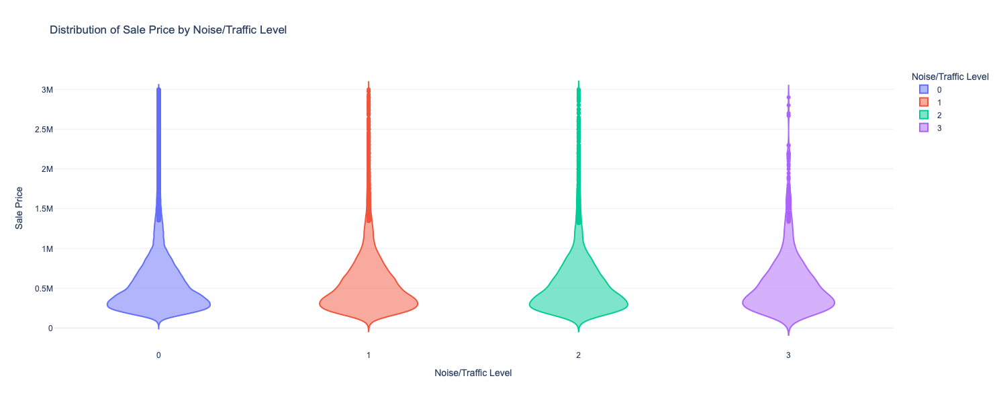

In [17]:

fig_original = px.violin(
    df,
    x='noise_traffic',  
    y='sale_price',     
    title='Distribution of Sale Price by Noise/Traffic Level', 
    labels={
        "noise_traffic": "Noise/Traffic Level", 
        "sale_price": "Sale Price"          
    },
    color='noise_traffic', 
    points="outliers",     
    width=800,            
    height=400             
)


fig_original.update_layout(
    xaxis_title="Noise/Traffic Level",
    yaxis_title="Sale Price",
    font=dict(
        family="Arial, sans-serif",
        size=12,
    ),
    template="plotly_white",
    width=800,  
    height=600
)

print("Violin Plot for Original Sale Price:")
fig_original.show()

# ML

## Linear Regresssion

In [7]:
df.dtypes

sale_date                datetime64[ns]
sale_price                        int64
sale_nbr                        float64
sale_warning                     object
latitude                        float64
longitude                       float64
area                              int64
city                             object
zoning                           object
subdivision                      object
present_use                       int64
land_val                          int64
imp_val                           int64
year_built                        int64
year_reno                         int64
sqft_lot                          int64
sqft                              int64
sqft_1                            int64
sqft_fbsmt                        int64
grade                             int64
fbsmt_grade                       int64
condition                         int64
stories                         float64
beds                              int64
bath_full                         int64


### Feature engineering and data correction

In [8]:
city_corrections = {
    'SEA-TAC': 'SEATAC',
    'SeaTac': 'SEATAC',
    'SEATAC': 'SEATAC'
}
df['city'] = df['city'].apply(lambda x: city_corrections.get(x, x))

In [9]:
SEATTLE_LAT = 47.6062
SEATTLE_LON = -122.3321
EARTH_RADIUS_KM = 6371 

def haversine_distance(lat1, lon1, lat2, lon2, radius=EARTH_RADIUS_KM):
    
    lat1_rad = np.radians(lat1)
    lon1_rad = np.radians(lon1)
    lat2_rad = np.radians(lat2)
    lon2_rad = np.radians(lon2)
    
    dlon = lon2_rad - lon1_rad
    dlat = lat2_rad - lat1_rad

    a = np.sin(dlat / 2.0)**2 + np.cos(lat1_rad) * np.cos(lat2_rad) * np.sin(dlon / 2.0)**2
    c = 2 * np.arctan2(np.sqrt(a), np.sqrt(1.0 - a))
    
    distance = radius * c
    return distance

df['distance_from_seattle']=haversine_distance(df['latitude'], df['longitude'], SEATTLE_LAT,SEATTLE_LON ,EARTH_RADIUS_KM)

In [10]:



df['bathrooms_total'] = (
    df['bath_full'] +
    df['bath_3qtr'] * 0.75 +
    df['bath_half'] * 0.5
)

df['property_value_sum'] = df['land_val'] + df['imp_val']


view_columns = [col for col in df.columns if col.startswith('view_')]
if view_columns:
    df['view_score_sum'] = df[view_columns].sum(axis=1)


df['garage_and_garbage_sqft'] = df['garb_sqft'] + df['gara_sqft']


In [11]:
df['sqft*grade'] =df['sqft'] * df['grade']
df['sqft*beds'] =df['sqft'] * df['beds']
df['sqft*bathrooms_total'] =df['sqft'] * df['bathrooms_total']
df['condition*grade'] =df['grade'] * df['condition']

In [12]:
df['sqft^2'] = df['sqft']**2
df['sqft^3'] = df['sqft']**3

### LR1
#### Data revision and feature selection for Base LR

In [13]:
for column in df.columns:
    print("@@@@@@@@@@@@@@@@@@@@@")
    print(column)
    print(df[column].nunique())
    if df[column].nunique()>15000:
        print('numeric')
    else:
        print(df[column].value_counts())

@@@@@@@@@@@@@@@@@@@@@
sale_date
313
2004-06-15    1221
2006-06-15    1159
2005-06-15    1146
2021-06-15    1090
2017-06-15    1086
              ... 
2008-11-15     229
2024-01-15     228
2009-02-15     210
2009-01-15     154
2025-01-15      65
Name: sale_date, Length: 313, dtype: int64
@@@@@@@@@@@@@@@@@@@@@
sale_price
22687
numeric
@@@@@@@@@@@@@@@@@@@@@
sale_nbr
12
2.0     60735
1.0     48977
0.0     42182
3.0     29924
4.0     12167
5.0      4287
6.0      1280
7.0       333
8.0        84
9.0        22
10.0        5
11.0        4
Name: sale_nbr, dtype: int64
@@@@@@@@@@@@@@@@@@@@@
sale_warning
142
                 180689
 26                6831
 15                3723
 40                2235
 41                1999
                  ...  
 10 16                1
 10 29 34 56          1
 29 36                1
 10 26 60             1
 3 60                 1
Name: sale_warning, Length: 142, dtype: int64
@@@@@@@@@@@@@@@@@@@@@
latitude
5735
47.6911    128
47.6842    128
47.6867    127
47.6

In [77]:
target= 'sale_price'
cols_to_drop =[
    'sale_date',
    'sale_warning',
    'latitude',
    'longitude',
    'zoning',
    'subdivision',
    'sale_date_day'
]
cols_binary = [
    'golf',
    'greenbelt',
    'sale_date_is_weekend'
]
cols_one_hot = [
    'city',
    'present_use',
    'submarket',
    'sale_date_quarter',
]
cols_sin_cos =['sale_date_day_of_week',
'sale_date_month',
'sale_date_week']
cols_year=['sale_year', 'year_built','year_reno']
cols_numeric = ['noise_traffic',
 'fbsmt_grade',
 'view_lakesamm',
 'beds',
 'view_olympics',
 'stories',
 'grade',
 'bath_full',
 'view_lakewash',
 'view_skyline',
 'condition',
 'sqft_lot',
 'sqft_fbsmt',
 'imp_val',
 'sqft_1',
 'gara_sqft',
 'view_sound',
 'bath_3qtr',
 'view_otherwater',
 'view_cascades',
 'view_rainier',
 'area',
 'land_val',
 'bath_half',
 'garb_sqft',
 'view_other',
 'sale_nbr',
 'sqft',
 'wfnt',
 'view_territorial',
    'distance_from_seattle',
    'bathrooms_total',
    'property_value_sum',
    'view_score_sum',
    'garage_and_garbage_sqft',
    'sqft*grade',
    'sqft*beds',
    'sqft*bathrooms_total',
'condition*grade',
    'sqft^2',
'sqft^3'
               ]


In [78]:
len(set(cols_to_drop+cols_binary+cols_one_hot+cols_sin_cos+cols_year+cols_numeric))+1

62

In [79]:
len(df.columns)

62

#### Base LR

In [80]:
from sklearn.preprocessing import LabelEncoder, OneHotEncoder, MinMaxScaler, StandardScaler
from sklearn.impute import SimpleImputer
from sklearn.model_selection import train_test_split

In [81]:
def preprocess_dataframe(df_input, 
                         cols_to_drop, 
                         target, 
                         cols_binary, 
                         cols_one_hot,
                         cols_sin_cos, 
                         cols_year, 
                         cols_numeric):
    
    df = df_input.copy()

    #дропаем
    df = df.drop(columns=cols_to_drop, errors='ignore')

    #логарифмируем таргет
    df[target] = np.log1p(df[target])


    #создаем house_age
    df['house_age'] = df['sale_year'] - df['year_built']
    df['house_age'] = df['house_age'].apply(lambda x: max(0, x)) 
    
    #создаем since_last_renovation
    df['since_last_renovation'] = np.where(
        df['year_reno'] > 0,
        df['sale_year'] - df['year_reno'],
        df['sale_year'] - df['year_built']
    )
    
    #дропаем лишние колонки
    df = df.drop(columns=[col for col in cols_year if col in df.columns], errors='ignore')


    #бинарная кодировка
    encoders_bin = dict()
    for c in cols_binary:
        encoders_bin[c] = LabelEncoder()
        df[c] = encoders_bin[c].fit_transform(df[c])
    


    #one-hot
    encoders_oh = dict()
    for c in cols_one_hot:
        df = pd.get_dummies(df, columns=[c], prefix=c, drop_first=True)
        
        
        

    # циклическое время
    for col in cols_sin_cos:
        if col == 'sale_date_day_of_week':
            max_val = 7
        elif col == 'sale_date_month':
            max_val = 12
        elif col == 'sale_date_week':
            max_val = 52
        else:
            print(f"Предупреждение: Неизвестная циклическая колонка '{col}'. Пропущена.")
            continue

        df[f'{col}_sin'] = np.sin(2 * np.pi * df[col] / max_val)
        df[f'{col}_cos'] = np.cos(2 * np.pi * df[col] / max_val)
        df = df.drop(columns=[col])


    #split data
    X_train, X_test, y_train, y_test = train_test_split(df.drop(columns=[target]), df[target], test_size=0.2, random_state=42)
    
    #minmax scler
    
    features_for_scaling = cols_numeric + ['house_age', 'since_last_renovation']
    
    for col in cols_sin_cos:
        if f'{col}_sin' in X_train.columns and f'{col}_sin' not in features_for_scaling:
            features_for_scaling.append(f'{col}_sin')
        if f'{col}_cos' in X_train.columns and f'{col}_cos' not in features_for_scaling:
            features_for_scaling.append(f'{col}_cos')



    if features_for_scaling:

        imputer = SimpleImputer(strategy='mean')
        X_train[features_for_scaling] = imputer.fit_transform(X_train[features_for_scaling])
        X_test[features_for_scaling] = imputer.transform(X_test[features_for_scaling])

        scaler = MinMaxScaler()
        X_train[features_for_scaling] = scaler.fit_transform(X_train[features_for_scaling])
        X_test[features_for_scaling] = scaler.transform(X_test[features_for_scaling])

    
    return X_train, X_test, y_train, y_test

In [74]:
X_train, X_test, y_train, y_test =preprocess_dataframe(df, cols_to_drop, 
                         target, 
                         cols_binary, 
                         cols_one_hot,
                         cols_sin_cos, 
                         cols_year, 
                         cols_numeric)

In [75]:
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score

#### Metrics and coefficient

In [76]:
model = LinearRegression()
model.fit(X_train, y_train)



y_pred_log = model.predict(X_test)



y_test_original = np.expm1(y_test)
y_pred_original = np.expm1(y_pred_log)




mse_log = mean_squared_error(y_test, y_pred_log)
mae_log = mean_absolute_error(y_test, y_pred_log)
r2_log = r2_score(y_test, y_pred_log)

print(f"Метрики в логарифмированном масштабе:")
print(f"  MSE (log): {mse_log:.4f}")
print(f"  MAE (log):  {mae_log:.4f}")
print(f"  R^2 (log):  {r2_log:.4f}")


mse_original = mean_squared_error(y_test_original, y_pred_original)
mae_original = mean_absolute_error(y_test_original, y_pred_original)
r2_original = r2_score(y_test_original, y_pred_original)

print(f"\nМетрики в исходном масштабе (доллары):")
print(f"  MSE (original): {mse_original:.2f}")
print(f"  MAE (original):  {mae_original:.2f}")
print(f"  R^2 (original):  {r2_original:.4f}")

Метрики в логарифмированном масштабе:
  MSE (log): 0.1751
  MAE (log):  0.3289
  R^2 (log):  0.5422

Метрики в исходном масштабе (доллары):
  MSE (original): 94412233726.71
  MAE (original):  194003.45
  R^2 (original):  0.4582


In [51]:
model.intercept_

10.9170231175073

In [52]:
feature_names = X_train.columns

coefficients = pd.Series(model.coef_, index=feature_names)

In [53]:
coefficients.abs().sort_values(ascending=False)

sqft                         6.372569
sqft*grade                   4.579653
sqft*beds                    2.393770
sqft^2                       2.335924
grade                        2.249434
                               ...   
submarket_D                  0.005575
city_DES MOINES              0.004032
sale_date_day_of_week_cos    0.002290
sale_date_day_of_week_sin    0.002251
sale_date_quarter_2          0.001111
Length: 115, dtype: float64

In [200]:
import seaborn as sns
import matplotlib.pyplot as plt

In [28]:

corr_matrix = X_train.corr().abs()


upper_tri = corr_matrix.where(np.triu(np.ones(corr_matrix.shape), k=1).astype(bool))

correlation_threshold = 0.85 


highly_correlated_pairs = []
for i in range(upper_tri.shape[0]):
    for j in range(i + 1, upper_tri.shape[1]): 
        if upper_tri.iloc[i, j] > correlation_threshold:
            highly_correlated_pairs.append((upper_tri.columns[i], upper_tri.columns[j], upper_tri.iloc[i, j]))


highly_correlated_pairs.sort(key=lambda x: x[2], reverse=True)

if highly_correlated_pairs:
    print("\nОбнаружены пары признаков с абсолютной корреляцией выше {correlation_threshold}:")
    for feat1, feat2, corr_val in highly_correlated_pairs:
        print(f"  - '{feat1}' и '{feat2}': Корреляция = {corr_val:.4f}")


Обнаружены пары признаков с абсолютной корреляцией выше {correlation_threshold}:
  - 'sale_date_month_sin' и 'sale_date_week_sin': Корреляция = 0.9766
  - 'sale_date_month_cos' и 'sale_date_week_cos': Корреляция = 0.9737
  - 'sqft' и 'sqft*grade': Корреляция = 0.9735
  - 'sqft*grade' и 'sqft^2': Корреляция = 0.9608
  - 'sqft' и 'sqft^2': Корреляция = 0.9508
  - 'sqft*bathrooms_total' и 'sqft^2': Корреляция = 0.9460
  - 'house_age' и 'since_last_renovation': Корреляция = 0.9397
  - 'sqft*grade' и 'sqft*bathrooms_total': Корреляция = 0.9373
  - 'sqft' и 'sqft*beds': Корреляция = 0.9350
  - 'sqft' и 'sqft*bathrooms_total': Корреляция = 0.9333
  - 'sqft^2' и 'sqft^3': Корреляция = 0.9329
  - 'sqft*beds' и 'sqft*bathrooms_total': Корреляция = 0.9064
  - 'sqft*beds' и 'sqft^2': Корреляция = 0.9059
  - 'sqft*grade' и 'sqft*beds': Корреляция = 0.9027
  - 'view_territorial' и 'view_score_sum': Корреляция = 0.9005
  - 'bathrooms_total' и 'sqft*bathrooms_total': Корреляция = 0.8691


### LR2 - VIF correction 
#### Data revision and feature selection for LR2

In [82]:
target= 'sale_price'
cols_to_drop =[
    'sale_date',
    'sale_warning',
    'latitude',
    'longitude',
    'zoning',
    'subdivision',
    'sale_date_day'
]
cols_binary = [
    'golf',
    'greenbelt',
    'sale_date_is_weekend'
]
cols_one_hot = [
    'city',
    'present_use',
    'submarket',
    'sale_date_quarter',
]
cols_sin_cos =['sale_date_day_of_week',
'sale_date_month',
'sale_date_week']
cols_year=['sale_year', 'year_built','year_reno']
cols_numeric = ['noise_traffic',
 'fbsmt_grade',
 'view_lakesamm',
 'beds',
 'view_olympics',
 'stories',

 'view_lakewash',
 'view_skyline',

 'sqft_lot',
 'sqft_fbsmt',
 'imp_val',
 'sqft_1',
 'gara_sqft',
 'view_sound',

 'view_otherwater',
 'view_cascades',
 'view_rainier',
 'area',
 'land_val',

 'garb_sqft',
 'view_other',
 'sale_nbr',
 'sqft',
 'wfnt',
 'view_territorial',
    'distance_from_seattle',
    'bathrooms_total',
    'sqft*grade',

    'sqft*bathrooms_total',
'condition*grade','grade',   'sqft*beds', 'condition',    
                          'sqft^2'

               ]


In [55]:
len(set(cols_to_drop+cols_binary+cols_one_hot+cols_sin_cos+cols_year+cols_numeric))+1

55

In [56]:
len(df.columns)

62

In [83]:
from sklearn.preprocessing import LabelEncoder, OneHotEncoder, MinMaxScaler, StandardScaler
from sklearn.impute import SimpleImputer
from sklearn.model_selection import train_test_split

In [84]:
def preprocess_dataframe(df_input, 
                         cols_to_drop, 
                         target, 
                         cols_binary, 
                         cols_one_hot,
                         cols_sin_cos, 
                         cols_year, 
                         cols_numeric):
    
    df = df_input.copy()
      
    #логарифмируем таргет
    df[target] = np.log1p(df[target])
        
    #дропаем
    df = df.drop(columns=cols_to_drop, errors='ignore')


    #создаем house_age
    df['house_age'] = df['sale_year'] - df['year_built']
    df['house_age'] = df['house_age'].apply(lambda x: max(0, x)) 
    
    #создаем since_last_renovation
    df['since_last_renovation'] = np.where(
        df['year_reno'] > 0,
        df['sale_year'] - df['year_reno'],
        df['sale_year'] - df['year_built']
    )
    
    #дропаем лишние колонки
    df = df.drop(columns=[col for col in cols_year if col in df.columns], errors='ignore')

    #бинарная кодировка
    encoders_bin = dict()
    for c in cols_binary:
        encoders_bin[c] = LabelEncoder()
        df[c] = encoders_bin[c].fit_transform(df[c])
    
    #one-hot
    encoders_oh = dict()
    for c in cols_one_hot:
        df = pd.get_dummies(df, columns=[c], prefix=c, drop_first=True)

    # циклическое время
    for col in cols_sin_cos:
        if col == 'sale_date_day_of_week':
            max_val = 7
        elif col == 'sale_date_month':
            max_val = 12
        elif col == 'sale_date_week':
            max_val = 52
        else:
            print(f"Предупреждение: Неизвестная циклическая колонка '{col}'. Пропущена.")
            continue

        df[f'{col}_sin'] = np.sin(2 * np.pi * df[col] / max_val)
        df[f'{col}_cos'] = np.cos(2 * np.pi * df[col] / max_val)
        df = df.drop(columns=[col])
    df = df.drop(columns=['sale_date_week_sin','sale_date_week_cos'])
    
    df = df.drop(columns=['sqft^3','bath_full','bath_3qtr','bath_half', 'view_score_sum',     
                          'property_value_sum','garage_and_garbage_sqft','city_KING COUNTY'  ])
    #split data
    X_train, X_test, y_train, y_test = train_test_split(df.drop(columns=[target]), df[target], test_size=0.2, random_state=42)
    
    #minmax scler
    features_for_scaling = cols_numeric + ['house_age', 'since_last_renovation']
    
    for col in cols_sin_cos:
        if f'{col}_sin' in X_train.columns and f'{col}_sin' not in features_for_scaling:
            features_for_scaling.append(f'{col}_sin')
        if f'{col}_cos' in X_train.columns and f'{col}_cos' not in features_for_scaling:
            features_for_scaling.append(f'{col}_cos')

    if features_for_scaling:

        imputer = SimpleImputer(strategy='mean')
        X_train[features_for_scaling] = imputer.fit_transform(X_train[features_for_scaling])
        X_test[features_for_scaling] = imputer.transform(X_test[features_for_scaling])

        scaler = MinMaxScaler()
        X_train[features_for_scaling] = scaler.fit_transform(X_train[features_for_scaling])
        X_test[features_for_scaling] = scaler.transform(X_test[features_for_scaling])
    
    return X_train, X_test, y_train, y_test

In [85]:
X_train, X_test, y_train, y_test =preprocess_dataframe(df, cols_to_drop, 
                         target, 
                         cols_binary, 
                         cols_one_hot,
                         cols_sin_cos, 
                         cols_year, 
                         cols_numeric)

In [59]:
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score

#### Metrics and coefficient

In [60]:
model = LinearRegression()
model.fit(X_train, y_train)



y_pred_log = model.predict(X_test)



y_test_original = np.expm1(y_test)
y_pred_original = np.expm1(y_pred_log)




mse_log = mean_squared_error(y_test, y_pred_log)
mae_log = mean_absolute_error(y_test, y_pred_log)
r2_log = r2_score(y_test, y_pred_log)

print(f"Метрики в логарифмированном масштабе:")
print(f"  MSE (log): {mse_log:.4f}")
print(f"  MAE (log):  {mae_log:.4f}")
print(f"  R^2 (log):  {r2_log:.4f}")


mse_original = mean_squared_error(y_test_original, y_pred_original)
mae_original = mean_absolute_error(y_test_original, y_pred_original)
r2_original = r2_score(y_test_original, y_pred_original)

print(f"\nМетрики в исходном масштабе (доллары):")
print(f"  MSE (original): {mse_original:.2f}")
print(f"  MAE (original):  {mae_original:.2f}")
print(f"  R^2 (original):  {r2_original:.4f}")

Метрики в логарифмированном масштабе:
  MSE (log): 0.1758
  MAE (log):  0.3296
  R^2 (log):  0.5405

Метрики в исходном масштабе (доллары):
  MSE (original): 94654649372.42
  MAE (original):  194298.17
  R^2 (original):  0.4568


In [38]:
feature_names = X_train.columns
coefficients = pd.Series(model.coef_, index=feature_names)

In [39]:
coefficients.abs().sort_values(ascending=False)

sqft                         6.434638
sqft*grade                   4.792451
sqft^2                       2.757142
sqft*beds                    2.661128
grade                        2.280423
                               ...   
sale_date_is_weekend         0.005069
submarket_D                  0.003980
sale_date_day_of_week_cos    0.003415
sale_date_day_of_week_sin    0.002374
sale_date_quarter_2          0.000040
Length: 105, dtype: float64

In [40]:

corr_matrix = X_train.corr().abs()


upper_tri = corr_matrix.where(np.triu(np.ones(corr_matrix.shape), k=1).astype(bool))

correlation_threshold = 0.85 


highly_correlated_pairs = []
for i in range(upper_tri.shape[0]):
    for j in range(i + 1, upper_tri.shape[1]): 
        if upper_tri.iloc[i, j] > correlation_threshold:
            highly_correlated_pairs.append((upper_tri.columns[i], upper_tri.columns[j], upper_tri.iloc[i, j]))


highly_correlated_pairs.sort(key=lambda x: x[2], reverse=True)

if highly_correlated_pairs:
    print(f"Обнаружены пары признаков с абсолютной корреляцией выше {correlation_threshold}:")
    for feat1, feat2, corr_val in highly_correlated_pairs:
        print(f"  - '{feat1}' и '{feat2}': Корреляция = {corr_val:.4f}")

Обнаружены пары признаков с абсолютной корреляцией выше 0.85:
  - 'sqft' и 'sqft*grade': Корреляция = 0.9735
  - 'sqft*grade' и 'sqft^2': Корреляция = 0.9608
  - 'sqft' и 'sqft^2': Корреляция = 0.9508
  - 'sqft*bathrooms_total' и 'sqft^2': Корреляция = 0.9460
  - 'house_age' и 'since_last_renovation': Корреляция = 0.9397
  - 'sqft*grade' и 'sqft*bathrooms_total': Корреляция = 0.9373
  - 'sqft' и 'sqft*beds': Корреляция = 0.9350
  - 'sqft' и 'sqft*bathrooms_total': Корреляция = 0.9333
  - 'sqft*beds' и 'sqft*bathrooms_total': Корреляция = 0.9064
  - 'sqft*beds' и 'sqft^2': Корреляция = 0.9059
  - 'sqft*grade' и 'sqft*beds': Корреляция = 0.9027
  - 'bathrooms_total' и 'sqft*bathrooms_total': Корреляция = 0.8691


#### VIF

In [42]:
import pandas as pd
import numpy as np

from statsmodels.stats.outliers_influence import variance_inflation_factor
from statsmodels.tools.tools import add_constant

import warnings
from joblib import Parallel, delayed 

X_train_vif = add_constant(X_train)


def calculate_vif_for_feature(data_values, feature_index, feature_name):
    try:
        vif = variance_inflation_factor(data_values, feature_index)
        return feature_name, vif, None 
    except Exception as e:
        return feature_name, np.inf, str(e) 

with warnings.catch_warnings():
    warnings.simplefilter("ignore", RuntimeWarning)
    results = Parallel(n_jobs=-1)(
        delayed(calculate_vif_for_feature)(X_train_vif.values, i, X_train_vif.columns[i])
        for i in range(X_train_vif.shape[1])
    )

vif_data_raw = []
problematic_features_details = []

for feature_name, vif_value, error_message in results:
    if feature_name == 'const':
        continue
    vif_data_raw.append({'feature': feature_name, 'VIF': vif_value})
    if error_message is not None:
        problematic_features_details.append(f"  - {feature_name} (Причина: {error_message})")


vif_data = pd.DataFrame(vif_data_raw)
vif_data = vif_data.sort_values(by="VIF", ascending=False).reset_index(drop=True)

vif_data['corr'] = X_train[vif_data['feature']].corrwith(y_train).values

print(vif_data.head(20))


                 feature         VIF      corr
0             sqft*grade  179.799165  0.507045
1                   sqft   72.736472  0.486667
2   sqft*bathrooms_total   68.944726  0.455206
3        condition*grade   65.609970  0.346701
4                 sqft^2   63.188055  0.450765
5              sqft*beds   49.703996  0.432808
6              condition   49.354346  0.016081
7                  grade   47.254131  0.503077
8           city_SEATTLE   44.109460  0.100712
9            submarket_B   36.660072  0.044996
10           submarket_K   35.928538 -0.131849
11           submarket_I   29.992310 -0.196365
12           submarket_D   29.952149  0.170877
13           submarket_F   28.846386 -0.032193
14           submarket_R   26.155189  0.142574
15           submarket_O   24.436136  0.133229
16           submarket_C   22.903681  0.051921
17           submarket_M   22.634862 -0.090404
18           submarket_L   22.167871 -0.160028
19           submarket_N   21.089124  0.025062


In [61]:
print(vif_data)

                  feature         VIF      corr
0              sqft*grade  179.799165  0.507045
1                    sqft   72.736472  0.486667
2    sqft*bathrooms_total   68.944726  0.455206
3         condition*grade   65.609970  0.346701
4                  sqft^2   63.188055  0.450765
..                    ...         ...       ...
100                  golf    1.046583  0.044666
101      city_HUNTS POINT    1.044569  0.014417
102       city_BEAUX ARTS    1.042173  0.021601
103        city_SKYKOMISH    1.037642 -0.017580
104         present_use_6    1.023110 -0.036737

[105 rows x 3 columns]


### LR3 - Ridge

#### Eval and metrics

In [44]:
from sklearn.model_selection import GridSearchCV, KFold
from sklearn.linear_model import Ridge

In [88]:
ridge = Ridge(random_state=42)

param_grid = {
    'alpha': np.logspace(-3, 4, 20) 
}

cv = KFold(n_splits=5, shuffle=True, random_state=42)


grid_search = GridSearchCV(estimator=ridge,
                           param_grid=param_grid,
                           scoring='neg_root_mean_squared_error',
                           cv=cv,
                           n_jobs=-1,
                           verbose=1) 

grid_search.fit(X_train, y_train)


print(f"Лучшие гиперпараметры для Ridge: {grid_search.best_params_}")
print(f"Лучшая RMSE на кросс-валидации: {-grid_search.best_score_:.4f}")


best_ridge_model = grid_search.best_estimator_


y_pred_test = best_ridge_model.predict(X_test)


y_test_original = np.expm1(y_test)
y_pred_test_original = np.expm1(y_pred_test)

mse_test = mean_squared_error(y_test_original, y_pred_test_original)
r2_test = r2_score(y_test_original, y_pred_test_original)

mse_test_log = mean_squared_error(y_test, y_pred_test)
r2_test_log = r2_score(y_test, y_pred_test)

print(f"MSE на тестовой выборке : {mse_test_log:.4f}")
print(f"R2 на тестовой выборке : {r2_test_log:.4f}")

print(f"MSE на тестовой выборке (обратное логарифмирование): {mse_test:.4f}")
print(f"R2 на тестовой выборке (обратное логарифмирование): {r2_test:.4f}")


print("--- Коэффициенты лучшей Ridge-модели ---")
coefficients = pd.Series(best_ridge_model.coef_, index=X_train.columns)
print(coefficients.sort_values(key=abs, ascending=False).head(20)) # Выводим топ-20 по модулю
print(f"Intercept: {best_ridge_model.intercept_:.4f}")

Fitting 5 folds for each of 20 candidates, totalling 100 fits
Лучшие гиперпараметры для Ridge: {'alpha': 0.029763514416313176}
Лучшая RMSE на кросс-валидации: 0.4187
MSE на тестовой выборке : 0.1758
R2 на тестовой выборке : 0.5405
MSE на тестовой выборке (обратное логарифмирование): 94647706973.3386
R2 на тестовой выборке (обратное логарифмирование): 0.4568
--- Коэффициенты лучшей Ridge-модели ---
sqft                     6.406928
sqft*grade              -4.742752
sqft^2                  -2.765552
sqft*beds                2.637684
grade                    2.269869
sqft_lot                 2.203943
sqft*bathrooms_total    -2.043469
imp_val                  1.789285
garb_sqft                1.330570
bathrooms_total          1.316744
sale_nbr                 1.024215
land_val                -0.892127
house_age                0.763303
sqft_fbsmt              -0.754029
beds                    -0.751199
gara_sqft                0.498487
distance_from_seattle   -0.491624
view_lakesamm        

#### Linear Regression assumptions

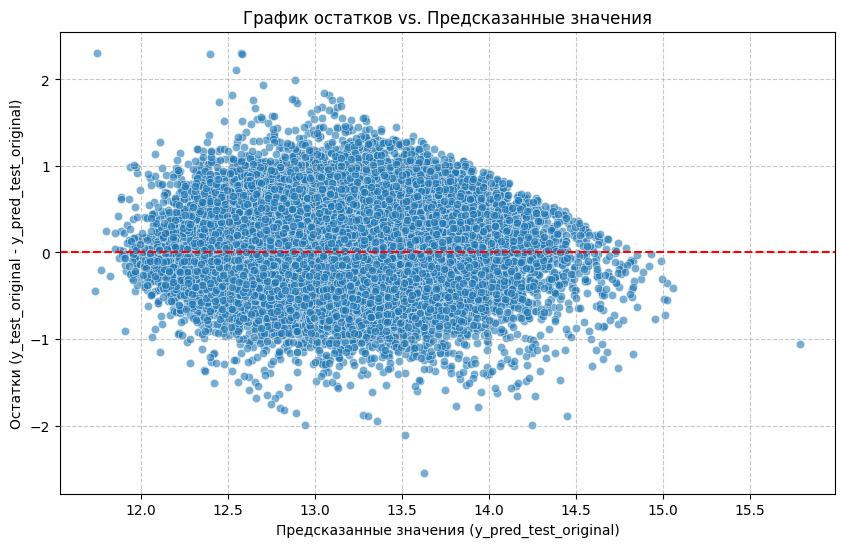

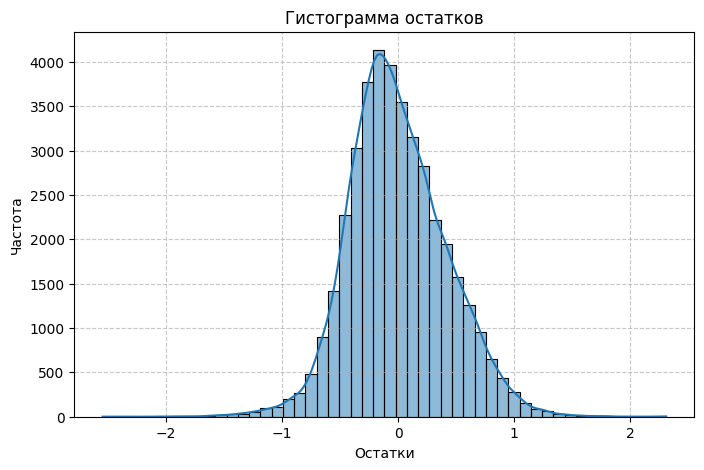

In [64]:
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import pandas as pd



residuals = y_test - y_pred_test


plt.figure(figsize=(10, 6))
sns.scatterplot(x=y_pred_test, y=residuals, alpha=0.6)
plt.axhline(y=0, color='r', linestyle='--') 
plt.title('График остатков vs. Предсказанные значения')
plt.xlabel('Предсказанные значения (y_pred_test_original)')
plt.ylabel('Остатки (y_test_original - y_pred_test_original)')
plt.grid(True, linestyle='--', alpha=0.7)
plt.show()


plt.figure(figsize=(8, 5))
sns.histplot(residuals, kde=True, bins=50)
plt.title('Гистограмма остатков')
plt.xlabel('Остатки')
plt.ylabel('Частота')
plt.grid(True, linestyle='--', alpha=0.7)
plt.show()


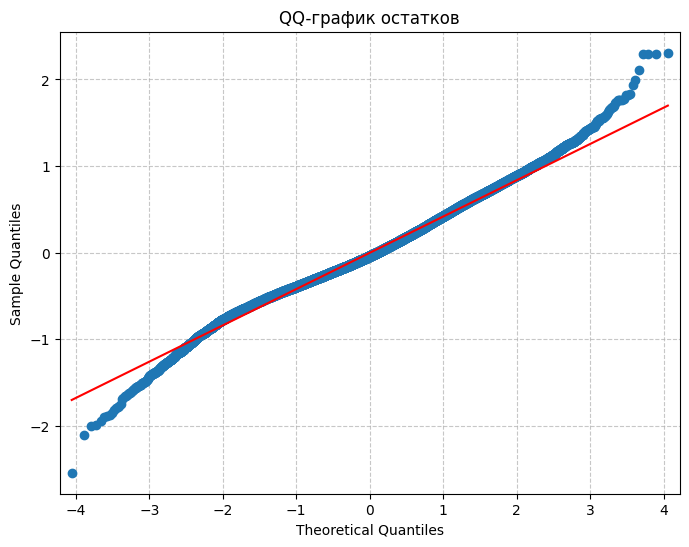

In [65]:
from statsmodels.graphics.gofplots import qqplot

plt.figure(figsize=(8, 6))
qqplot(residuals, line='s', ax=plt.gca()) 
plt.title('QQ-график остатков')
plt.grid(True, linestyle='--', alpha=0.7)
plt.show()

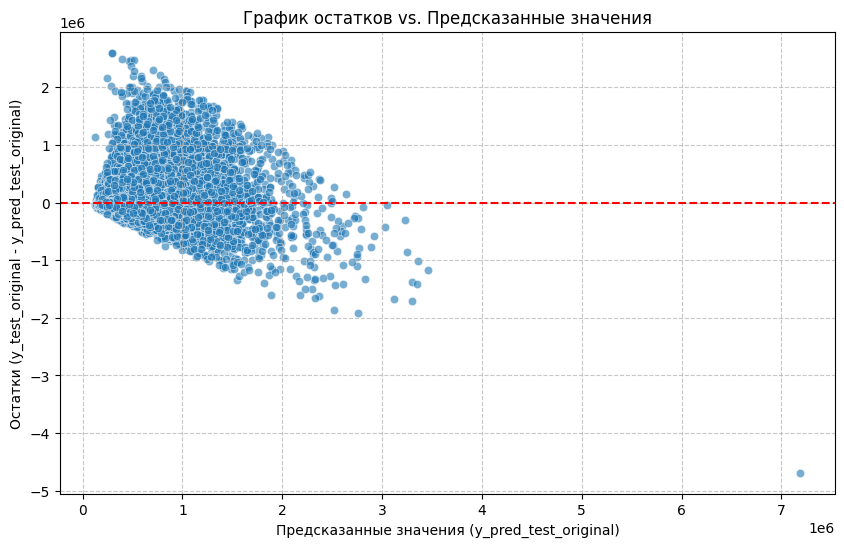

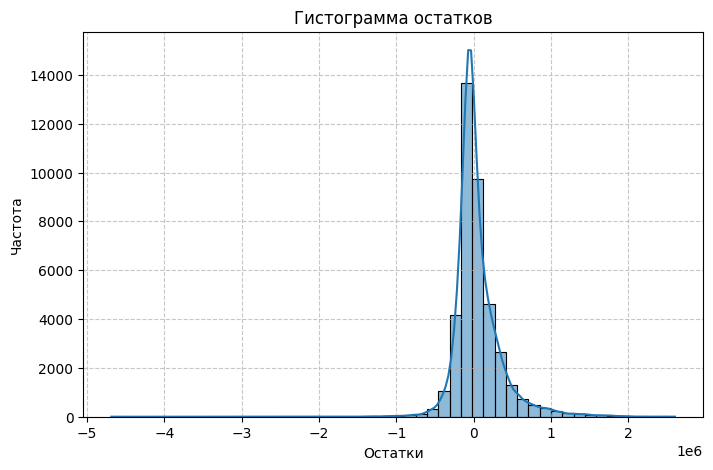

In [66]:
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import pandas as pd



residuals = y_test_original - y_pred_test_original


plt.figure(figsize=(10, 6))
sns.scatterplot(x=y_pred_test_original, y=residuals, alpha=0.6)
plt.axhline(y=0, color='r', linestyle='--') 
plt.title('График остатков vs. Предсказанные значения')
plt.xlabel('Предсказанные значения (y_pred_test_original)')
plt.ylabel('Остатки (y_test_original - y_pred_test_original)')
plt.grid(True, linestyle='--', alpha=0.7)
plt.show()


plt.figure(figsize=(8, 5))
sns.histplot(residuals, kde=True, bins=50)
plt.title('Гистограмма остатков')
plt.xlabel('Остатки')
plt.ylabel('Частота')
plt.grid(True, linestyle='--', alpha=0.7)
plt.show()


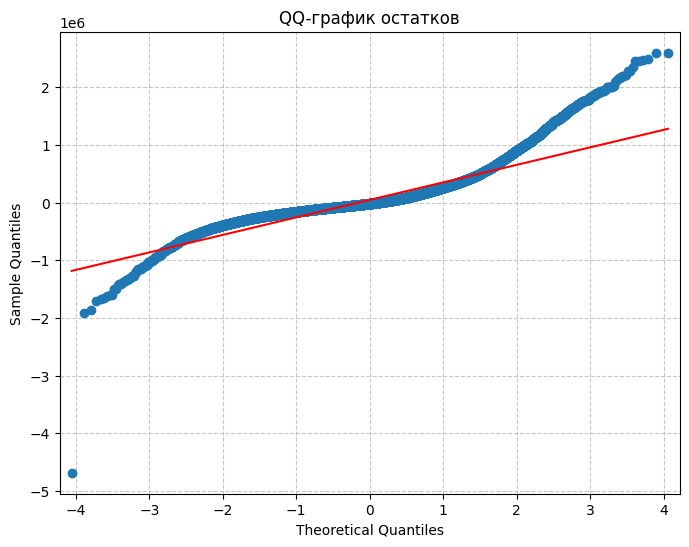

In [68]:

from statsmodels.graphics.gofplots import qqplot

plt.figure(figsize=(8, 6))
qqplot(residuals, line='s', ax=plt.gca()) 
plt.title('QQ-график остатков')
plt.grid(True, linestyle='--', alpha=0.7)
plt.show()